<a href="https://colab.research.google.com/github/tjunjet/til_nothing/blob/yl_cv/TIL_Detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# mount google drive to colab

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# install dependencies: 
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# install detectron2:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8 MB 21 kB/s 
     |████████████████████████████████| 6.6 MB 4.5 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.11.0+cu113
    Uninstalling torch-1.11.0+cu113:
      Successfully uninstalled torch-1.11.0+cu113
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.12.0+cu113
    Uninstalling torchvision-0.12.0+cu113:
      Successfully uninstalled torchvision-0.12.0+cu113
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.12.0 requires torch==1.11.0, but you have torch 1.5.0+cu101 which is incompatible.
torchaudio 0.11.0+cu113 requires torch==1.11.0, but you have torch 1.5.0+cu101 

In [3]:
# You may need to restart your runtime prior to this, to let your installation take effect
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

In [4]:
# load files (create a shortcut to mydrive first)

import os
os.chdir("/content/drive/MyDrive/")

# format files

import json
from detectron2.structures import BoxMode
def get_person_dict(data):
  json_file = "Qualifiers/CV Training Dataset/training_data_new.json"
  with open(json_file) as f:
    original_dataset_dicts = json.load(f)
    images = original_dataset_dicts['images']
    annotations = original_dataset_dicts['annotations']
    categories = original_dataset_dicts['categories']
  for i in images:
    i['image_id'] = i['id']
    matching_annotations = list(filter(lambda annotation: annotation['image_id'] == i['id'], 
                                        annotations))
    i['annotations'] = matching_annotations
    file_name = i['file_name']
    i['file_name'] = 'Qualifiers/CV Training Dataset/Images/' + file_name
    for j in i["annotations"]:
      j["bbox_mode"] = BoxMode.XYWH_ABS #Setting the required Box Mode
      if j['category_id'] == 1:
        j['category_id'] = int(0)
      if j['category_id'] == 2:
        j['category_id'] = int(1)
  no_images = len(images)
  if data == "train":
    return images[:int(4 * no_images / 5)]
  elif data == "val":
    return images[int(4 * no_images / 5):]
  else:
    return []

from detectron2.data import DatasetCatalog, MetadataCatalog
#Registering the Dataset
for d in ['train', 'val']:
  DatasetCatalog.register("person_" + d, lambda d=d: get_person_dict(d))
  MetadataCatalog.get("person_" + d).set(thing_classes=["Fallen","Standing"])
person_metadata = MetadataCatalog.get("person_train")

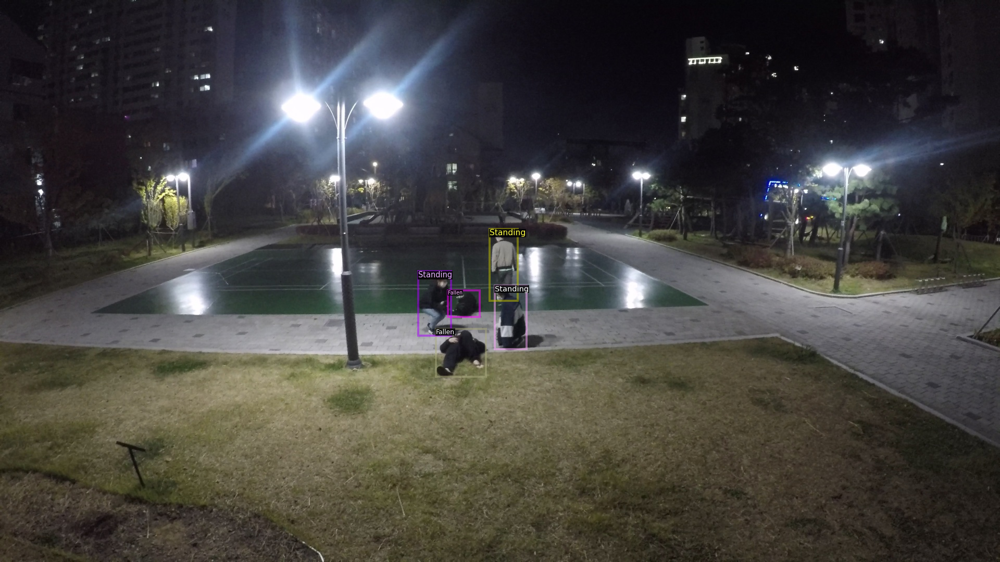

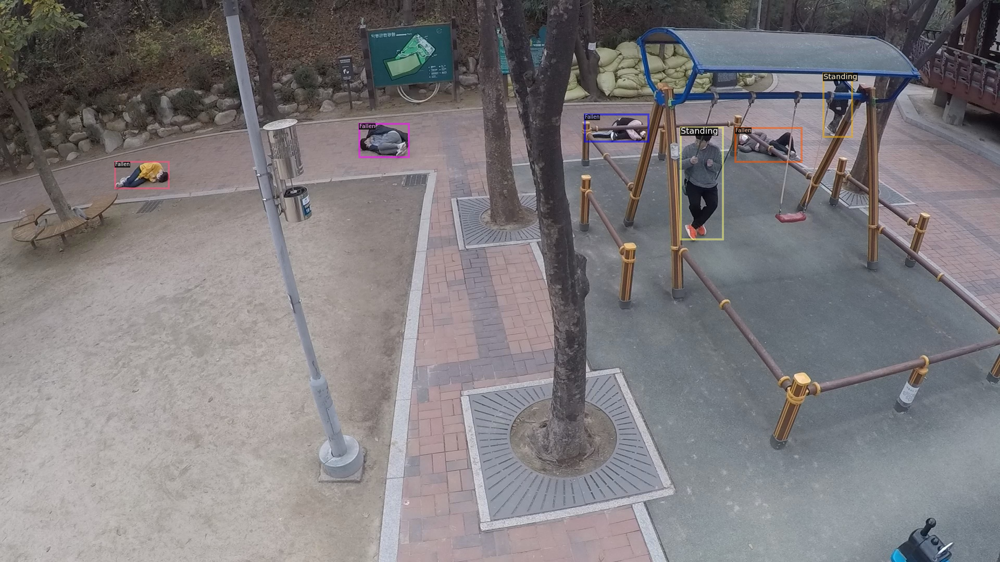

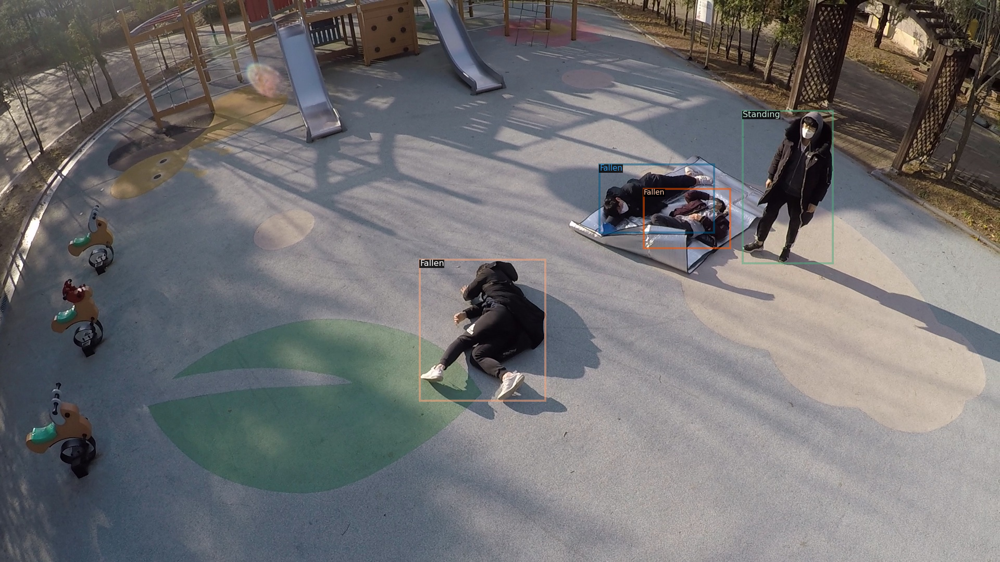

In [5]:
#Visualizing the Train Dataset
dataset_dicts = get_person_dict("train")
#Randomly choosing 3 images from the Set
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=person_metadata)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [ ]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
# training the model

from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")) #Get the basic model configuration from the model zoo 
#Passing the Train and Validation sets
cfg.DATASETS.TRAIN = ("person_train",)
cfg.DATASETS.TEST = ("person_val",)
# Number of data loading threads
cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
# Number of images per batch across all machines.
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.0125  # pick a good LearningRate
cfg.SOLVER.MAX_ITER = 500  #No. of iterations (was 1500, reduced cuz i want to sleep)
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256  
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2 # No. of classes = ["Fallen","Standing"]
cfg.TEST.EVAL_PERIOD = 500 # No. of iterations after which the Validation Set is evaluated. 
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[06/02 21:34:16 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (3, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, we

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

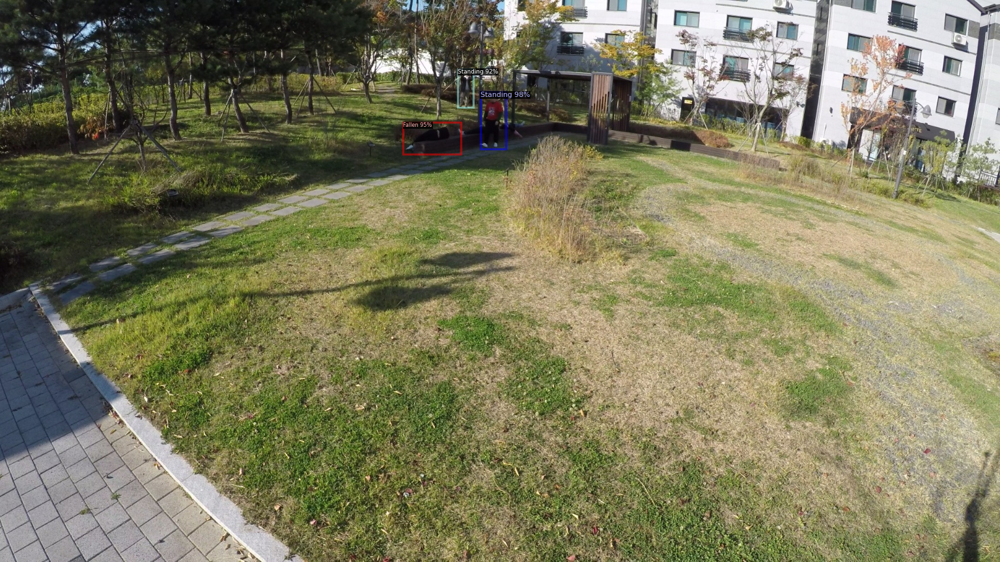

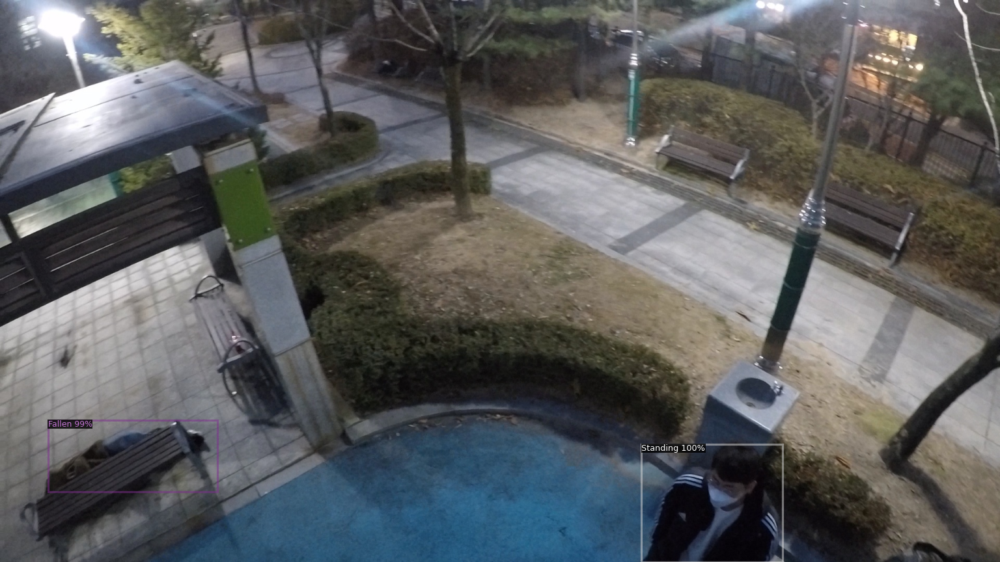

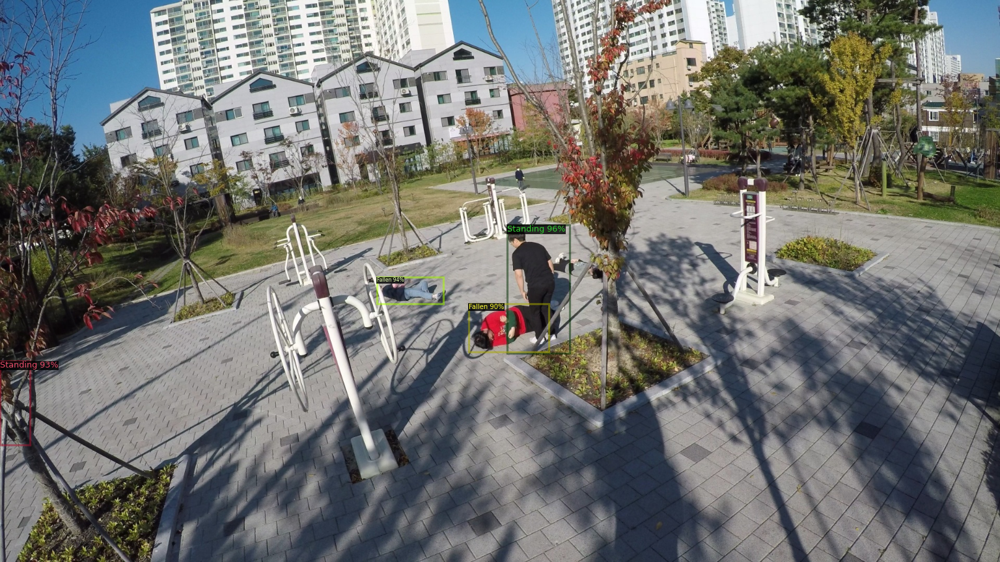

In [ ]:
from detectron2.utils.visualizer import ColorMode

#Use the final weights generated after successful training for inference  
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")

cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8  # set the testing threshold for this model
#Pass the validation dataset
cfg.DATASETS.TEST = ("person_val", )

predictor = DefaultPredictor(cfg)

dataset_dicts = get_person_dict("val")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=person_metadata, 
                   scale=0.8,
                   instance_mode=ColorMode.IMAGE   
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu")) #Passing the predictions to CPU from the GPU
    cv2_imshow(v.get_image()[:, :, ::-1])

In [ ]:
#import the COCO Evaluator to use the COCO Metrics
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

#Call the COCO Evaluator function and pass the Validation Dataset
evaluator = COCOEvaluator("person_val", cfg, False, output_dir="/output/")
val_loader = build_detection_test_loader(cfg, "person_val")

#Use the created predicted model in the previous step
inference_on_dataset(predictor.model, val_loader, evaluator)

WARNING [06/02 21:36:14 d2.evaluation.coco_evaluation]: json_file was not found in MetaDataCatalog for 'person_val'. Trying to convert it to COCO format ...
[06/02 21:36:14 d2.data.datasets.coco]: Converting annotations of dataset 'person_val' to COCO format ...)
[06/02 21:36:36 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[06/02 21:36:36 d2.data.datasets.coco]: Conversion finished, #images: 1200, #annotations: 5163
[06/02 21:36:36 d2.data.datasets.coco]: Caching COCO format annotations at '/output/person_val_coco_format.json' ...
[06/02 21:36:58 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|   Fallen   | 2658         |  Standing  | 2505         |
|            |              |            |              |
|   total    | 5163         |            |              |
[06/02 21:36:58 d2.data.common]: Serializing 1200 elements to byte ten

OrderedDict([('bbox',
              {'AP': 59.38656828617175,
               'AP-Fallen': 57.8526328757351,
               'AP-Standing': 60.92050369660842,
               'AP50': 84.68813484365126,
               'AP75': 72.40765338609279,
               'APl': nan,
               'APm': nan,
               'APs': 65.19726118238219})])

In [ ]:
print(get_person_dict("val"))

[{'file_name': 'Qualifiers/CV Training Dataset/Images/XwlVpPIvLc1uwprqj4FgXu892w.jpg', 'height': 1080, 'width': 1920, 'id': 4801, 'image_id': 4801, 'annotations': [{'area': 4400, 'iscrowd': 0, 'bbox': [1115, 279, 88, 50], 'category_id': 0, 'ignore': 0, 'segmentation': [], 'image_id': 4801, 'id': 20094, 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'area': 4830, 'iscrowd': 0, 'bbox': [1059, 218, 138, 35], 'category_id': 0, 'ignore': 0, 'segmentation': [], 'image_id': 4801, 'id': 20095, 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'area': 4280, 'iscrowd': 0, 'bbox': [1447, 132, 40, 107], 'category_id': 1, 'ignore': 0, 'segmentation': [], 'image_id': 4801, 'id': 20096, 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'area': 2450, 'iscrowd': 0, 'bbox': [1287, 216, 50, 49], 'category_id': 0, 'ignore': 0, 'segmentation': [], 'image_id': 4801, 'id': 20097, 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'area': 6096, 'iscrowd': 0, 'bbox': [1250, 275, 127, 48], 'category_id': 0, 'ignore': 0, 'segmentation': [], 'image_id': 4801